#### Problem Statement
YayYay, a payment processing company headquartered in Japan, initiated operations in 2019. The business team is keen on forecasting GMV (Gross Merchandise Value), which represents the total transaction amounts over a specified duration. GMV can be assessed per store (the seller), per user (the purchaser), or aggregated for YayYay as a whole (encompassing all users and stores). The business team has provided datasets in CSV format:

transactions: Contains all transactions spanning 2020 and 2021, comprising user ID (user_id), store ID (store_id), transaction datetime (event_occurrence), and transaction amount in yen (amount).

stores: Encompasses store characteristics like prefecture (nam), local administrative area (laa), category, and geographical coordinates in latitude (lat) and longitude (lon).

users: Comprises user attributes such as gender and age as of December 31, 2021.

Tasks to be performed:

Exploratory Data Analysis (EDA): Conduct an EDA to discern patterns within the data, utilizing preferred visualizations.

Forecasting GMV for Each User in January 2022: Develop forecasts for GMV for individual users for the month of January 2022.

Forecasting YayYay's GMV for January 2022: Generate forecasts for YayYay's overall GMV for each day in January 2022.

Submission Requirements:

Submit a Jupyter notebook or a combination of code and documentation elucidating the modeling, methodology, and findings.
Include CSV files for the user forecasts and YayYay's overall forecast.

#### Imports

In [1]:
import os
import math
import random
import pandas as pd
import numpy as np
import seaborn as sns
from datetime import datetime as dt

# plotly
import plotly.express as px
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# metrics
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

# statsmodels
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.seasonal import seasonal_decompose

# prophet model
from prophet import Prophet

# tensorflow
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, GRU, Dropout

#### Initilizing data location

In [2]:
file_path = "/Users/alokchauhan/Downloads/data/Coding Challenge - Data(20221128)/"

#### Loading data

In [3]:
# loading users table
users_df = pd.read_csv(os.path.join(file_path, 'users.csv'))

# loading transactions table
transactions_df = pd.read_csv(os.path.join(file_path, 'transactions.csv'))

# loading stores table
stores_df = pd.read_csv(os.path.join(file_path, 'stores.csv'))

#### Data Exploration

##### 1. Show first 5 rows

In [4]:
users_df.head(5)

,id,gender,age
0,3cf2d95c-851a-3e66-bd62-36050c1aa8dd,M,30.0
1,a85536f3-1bf8-fbeb-d06e-62e6dc5a2a83,M,55.0
2,355a293c-2c15-d6bd-45ce-cd3c275ee5a9,M,40.0
3,61fb5b45-9bf8-1659-7a0c-b6f85a0f870b,NaN,NaN
4,ff9e16ef-3a0b-9373-567f-fb07cbc96874,M,90.0


In [5]:
transactions_df.head(5)

,id,user_id,store_id,event_occurrence,amount
0,a555eb55-1da4-6087-b5ab-06b35b608002,93098549-3ff0-e579-01c3-df9183278f64,a3c7874b-75df-9cf2-62ab-cf58be5d9e0e,2020-01-01 06:40:43.323987,315
1,f699b867-e70c-5160-90c8-7dfa32dce0da,35ba9da1-98d0-cbb7-7844-e648601b7208,1d59adf3-94f2-f5f8-46c6-8558c544a3a9,2020-01-01 07:04:25.968615,1646
2,5c3f8abc-f4e6-94fd-7b13-fe0efd4e4591,63cb5ee0-a457-9975-5455-4d76109bc754,c835f09d-ac5b-2005-1959-f452456a746a,2020-01-01 07:06:16.164563,385
3,f033da1a-bafb-5faa-67e3-c76b07b04333,786fcb82-40cf-1dc9-b9ba-2541502ca95a,eaf4c05d-13e1-7c8a-9ae0-cf2ec2e3dcd2,2020-01-01 07:07:26.029685,166
4,ccc35ffe-ee42-b696-783c-6670bfd800ec,acc814f5-beb6-db35-64f1-52f7c5a8466c,a8301ae2-df3b-ffe4-0279-c74af1dbb847,2020-01-01 07:12:24.448015,656


In [6]:
stores_df.head(5)

,id,nam,laa,category,lat,lon
0,139a9a4b-1cb4-cb91-f718-d0bdd7db31c9,Aichi Ken,Agui Cho,ショッピング,34.951439,136.935126
1,437e0dae-dbf7-b1a8-4a03-010b9597bbd2,Aichi Ken,Agui Cho,マッサージ,34.947078,136.884972
2,2deb0ff0-5909-c169-4a23-4ed3979467fc,Aichi Ken,Agui Cho,その他,34.926083,136.928418
3,093585a3-96ce-7513-4d60-1dd36c4b30d2,Aichi Ken,Agui Cho,カフェ,34.952815,136.889037
4,d0637fde-e4c8-4c60-5817-a3494a623a6f,Aichi Ken,Agui Cho,グルメ,34.922963,136.892997


##### 2. Analyse missing values

In [7]:
# There are few nulls in gender and age columns.
users_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9961 entries, 0 to 9960
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      9961 non-null   object 
 1   gender  8965 non-null   object 
 2   age     9463 non-null   float64
dtypes: float64(1), object(2)
memory usage: 233.6+ KB


In [8]:
# No nulls in any column
transactions_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1582260 entries, 0 to 1582259
Data columns (total 5 columns):
 #   Column            Non-Null Count    Dtype 
---  ------            --------------    ----- 
 0   id                1582260 non-null  object
 1   user_id           1582260 non-null  object
 2   store_id          1582260 non-null  object
 3   event_occurrence  1582260 non-null  object
 4   amount            1582260 non-null  int64 
dtypes: int64(1), object(4)
memory usage: 60.4+ MB


In [9]:
# No null in any of the columns below 
stores_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99991 entries, 0 to 99990
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   id        99991 non-null  object 
 1   nam       99991 non-null  object 
 2   laa       99991 non-null  object 
 3   category  99991 non-null  object 
 4   lat       99991 non-null  float64
 5   lon       99991 non-null  float64
dtypes: float64(2), object(4)
memory usage: 4.6+ MB


##### 3. Joining tables

In [10]:
# Merging transactions and stores data
transaction_and_store_df = pd.merge(transactions_df, stores_df, left_on='store_id', right_on='id')

# Finally, merging transactions and stores data from above to users data
df = pd.merge(users_df, transaction_and_store_df, left_on='id', right_on='user_id')

##### 4. Remove non-required columns after join

In [11]:
df = df.drop(columns=['id_x', 'id_y', 'user_id'])

##### 5. Analysing gender distribution

In [12]:
# gender and age are the only columns with missing values
missing = df.isnull().sum()

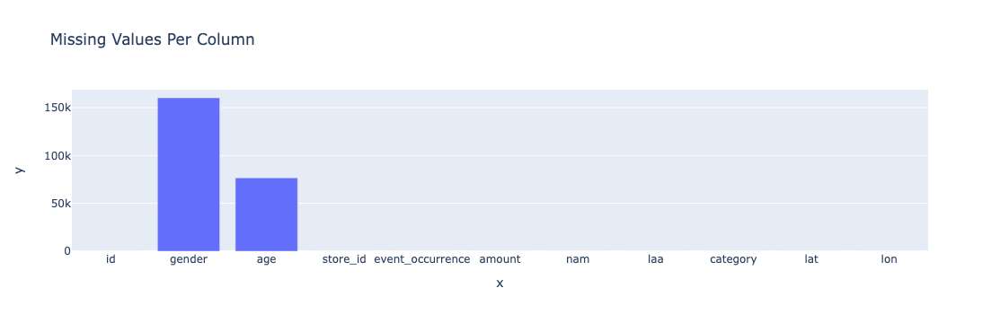

In [13]:
fig = px.bar(x=missing.index, y=missing.values, title= "Missing Values Per Column")
fig.show()

In [14]:
# gender distribution before imputation
gender_distribution_before = df.gender.value_counts()

# filling empty with mode value
df['gender'] = df['gender'].fillna(df.gender.mode()[0])

# gender distribution after imputation
gender_distribution_after = df.gender.value_counts()

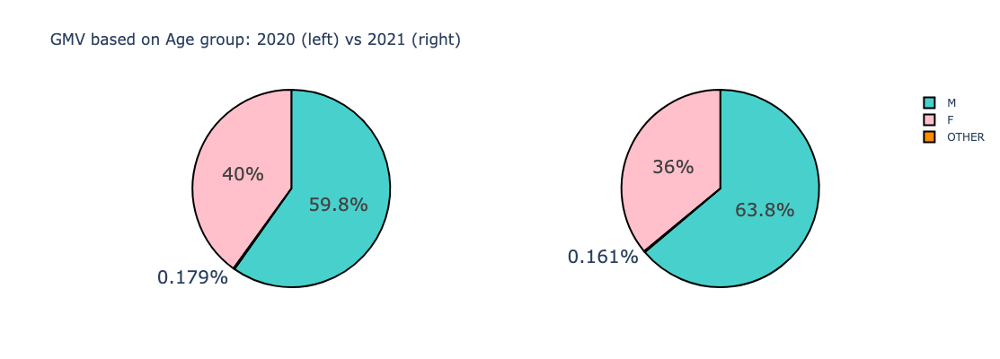

In [15]:
# Define colors for the Pie charts
colors = ['mediumturquoise', 'pink', 'darkorange', 'lightgreen']

# Create subplots with 1 row and 2 columns, specifying that each subplot is a Pie chart ("domain")
fig = make_subplots(rows=1, cols=2, specs=[[{"type": "domain"}, {"type": "domain"}]])

# Add Pie chart for data before to the first subplot (left)
fig.add_trace(go.Pie(labels=gender_distribution_before.index, values=gender_distribution_before.values), row=1, col=1)

# Add Pie chart for data after to the second subplot (right)
fig.add_trace(go.Pie(labels=gender_distribution_after.index, values=gender_distribution_after.values), row=1, col=2)

# Update layout of the combined figure
fig.update_layout(height=400, title_text="GMV based on Age group: 2020 (left) vs 2021 (right)")

# Update style and appearance of the Pie charts
fig.update_traces(textinfo='percent', textfont_size=20, marker=dict(colors=colors, line=dict(color='#000000', width=2)))

# Show the combined figure
fig.show()

##### 6. Analysing age distribution

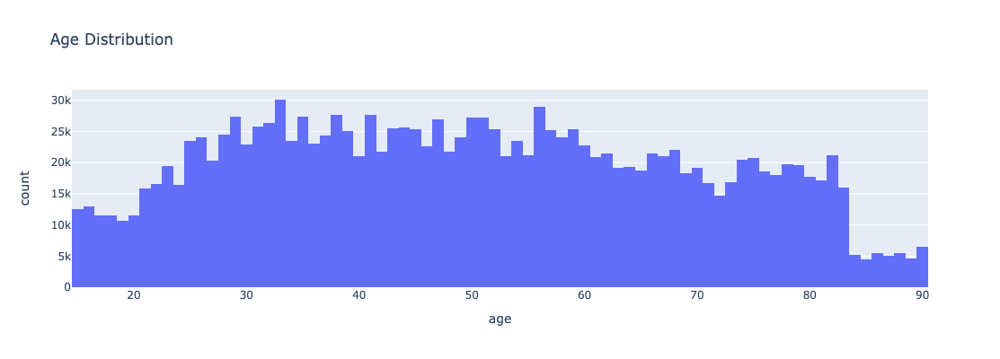

In [16]:
fig = px.histogram(df, x="age", height=400, width=600, title= "Age Distribution")

fig.show()

In [17]:
# we can observe symmetry in above age distribution, therefore imputing age with mean.
df['age'] = df['age'].fillna(df['age'].mean())

In [18]:
# create age bins and age groups, this will help our predictions and analysis further.
bin_edges = [0, 20, 40, 60, 100]  # Define the edges of bins
bin_labels = ['Young(<20)', 'Adult(21-40)', 'Middle-Aged(41-60)','Senior(60+)']  # Define labels for each bin

# adding new age group column
df['age_group'] = pd.cut(df['age'], bins=bin_edges, labels=bin_labels, right=False)

In [19]:
age_group_counts = df['age_group'].value_counts()

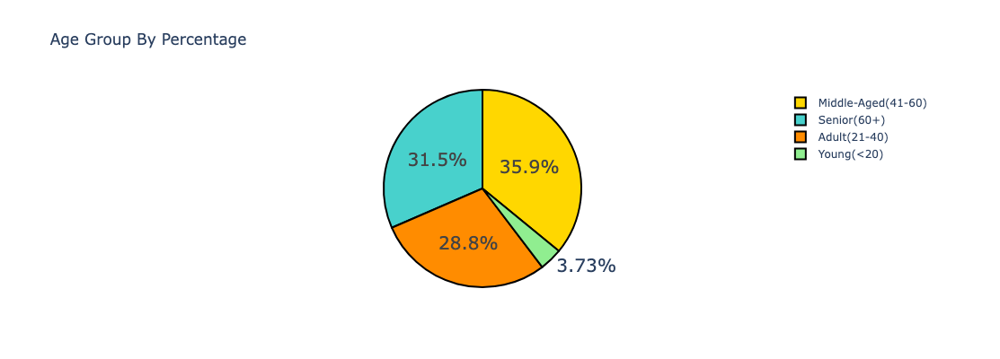

In [20]:
# Pie chart to show age_group percentage
colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']
fig = go.Figure(data=[go.Pie(labels=age_group_counts.index, values=age_group_counts.values)])
fig.update_layout(height=400, title_text="Age Group By Percentage")
fig.update_traces(textinfo='percent', textfont_size=20, marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.show()

In [21]:
df.info() # No Null in any column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1582260 entries, 0 to 1582259
Data columns (total 12 columns):
 #   Column            Non-Null Count    Dtype   
---  ------            --------------    -----   
 0   id                1582260 non-null  object  
 1   gender            1582260 non-null  object  
 2   age               1582260 non-null  float64 
 3   store_id          1582260 non-null  object  
 4   event_occurrence  1582260 non-null  object  
 5   amount            1582260 non-null  int64   
 6   nam               1582260 non-null  object  
 7   laa               1582260 non-null  object  
 8   category          1582260 non-null  object  
 9   lat               1582260 non-null  float64 
 10  lon               1582260 non-null  float64 
 11  age_group         1582260 non-null  category
dtypes: category(1), float64(3), int64(1), object(7)
memory usage: 134.3+ MB


##### 7. Deriving new columns from event_occurrence for further analysis

In [22]:
# deriving date, month, year, time, day from event_occurrence
df['event_occurrence'] = pd.to_datetime(df['event_occurrence'])
df['date'] = df['event_occurrence'].dt.date
df['month'] = df['event_occurrence'].dt.month
df['year'] = df['event_occurrence'].dt.year
df['time'] = df['event_occurrence'].dt.time
df['day'] = df['event_occurrence'].dt.day

In [23]:
japanese_meaning_dict = {
    'コンビニ': 'Convenience store',
    'エンタメ': 'Entertainment',
    'スーパーマーケット': 'Supermarket',
    '家電・携帯電話': 'Home appliances / Mobile phones',
    'ホテル・旅館': 'Hotel / Ryokan (Japanese inn)',
    'ショッピング': 'Shopping',
    'グルメ': 'Gourmet',
    'ファッション': 'Fashion',
    'クリーニング': 'Dry cleaning',
    'カフェ': 'Cafe',
    'その他': 'Others',
    'マッサージ': 'Massage',
    'ドラッグストア・薬局': 'Drugstore / Pharmacy',
    '美容院・サロン': 'Beauty salon',
    '百貨店・ショッピングセンター': 'Department store / Shopping center',
    '病院・クリニック': 'Hospital / Clinic'
}

df['category'] = df['category'].replace(japanese_meaning_dict)

##### 8. Visualising top 10 nam GMV in a year

In [24]:
# visualizing top 10 nam
nam_sales = df.groupby(['nam', 'year']).agg({'amount': 'sum'}).reset_index()

temp_df_list = []
for year in nam_sales.year.unique():
    temp = nam_sales[nam_sales.year == year].sort_values(by=['amount'], ascending=False)
    temp_df_list.append(temp.head(10))

nam_sales = pd.concat(temp_df_list)
nam_sales['year'] = nam_sales['year'].astype('object')

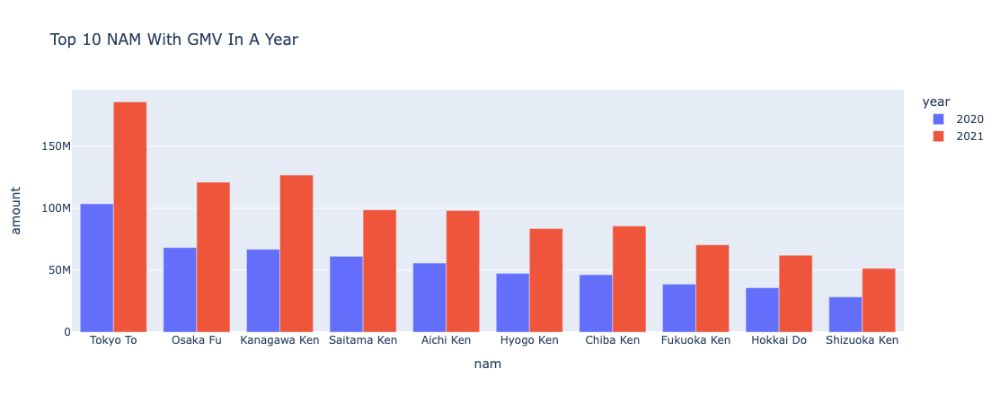

In [25]:
fig = px.bar(nam_sales, x="nam", y="amount", color='year', barmode='group', height=450, title=' Top 10 NAM With GMV In A Year')
fig.show()

#### 9. Analysing GMV of top 10 laa for "Tokyo To"

In [26]:
# Analysing "Tokyo To"
nam = 'Tokyo To'
tokyo_to = df[df.nam == nam].groupby(['nam', 'laa', 'year']).agg({'amount': 'sum'}).reset_index()
tokyo_to = tokyo_to.sort_values(by=['amount'], ascending=False)

temp_df_list = []
for year in tokyo_to.year.unique():
    temp = tokyo_to[tokyo_to.year == year].sort_values(by=['amount'], ascending=False)
    temp_df_list.append(temp.head(10))

tokyo_to = pd.concat(temp_df_list)

# converting year to object for plotting
tokyo_to['year'] = tokyo_to['year'].astype('object')

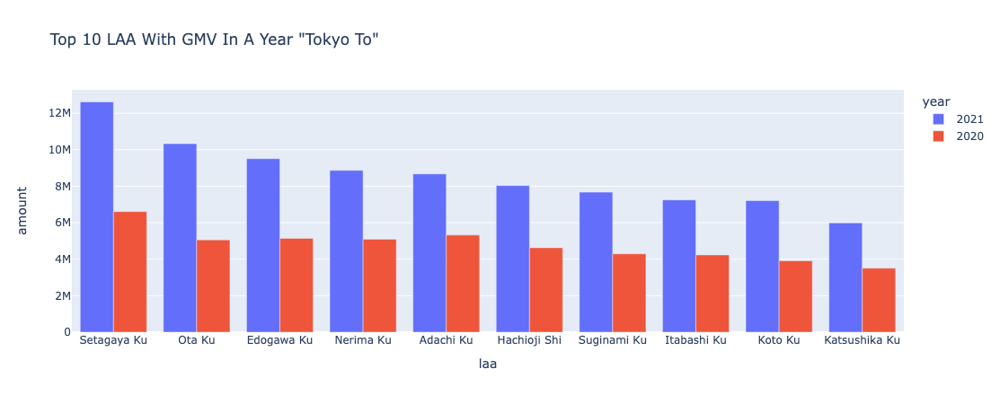

In [27]:
fig = px.bar(tokyo_to, x="laa", y="amount", color='year', barmode='group', height=450, title=f'Top 10 LAA With GMV In A Year "{nam}"')
fig.show()

#### 10. Analysing GMV based on Gender and Age group

In [28]:
age_group_df = df.groupby(['age_group', 'year']).agg({'amount': 'sum'}).reset_index()

# converting year to object for plotting
age_group_df['year'] = age_group_df['year'].astype('object')

/var/folders/5g/d264hcgd60d1mxb1l4_f6vrr0000gn/T/ipykernel_93187/896771898.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



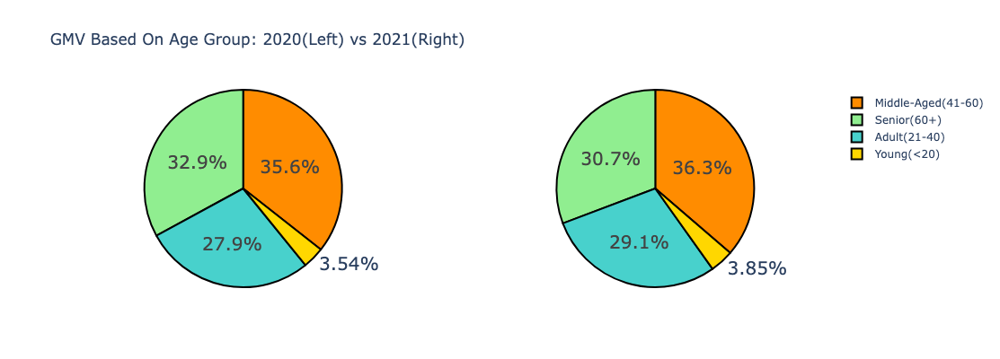

In [29]:
# separating yearwise data for visulizing
age_data_2020 = age_group_df[age_group_df.year == 2020]
age_data_2021 = age_group_df[age_group_df.year == 2021]

colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']
fig = make_subplots(rows=1, cols=2,
specs=[[{"type": "domain"}, {"type": "domain"}]])

fig.add_trace(go.Pie(labels=age_data_2020.age_group, values=age_data_2020.amount.values), row=1, col=1)
fig.add_trace(go.Pie(labels=age_data_2021.age_group, values=age_data_2021.amount.values), row=1, col=2)

fig.update_layout(height=400, title_text="GMV Based On Age Group: 2020(Left) vs 2021(Right)")
fig.update_traces(textinfo='percent', textfont_size=20, marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.show()

In [30]:
gender_df = df.groupby(['gender', 'year']).agg({'amount': 'sum'}).reset_index()

# converting year to object for plotting
gender_df['year'] = gender_df['year'].astype('object')

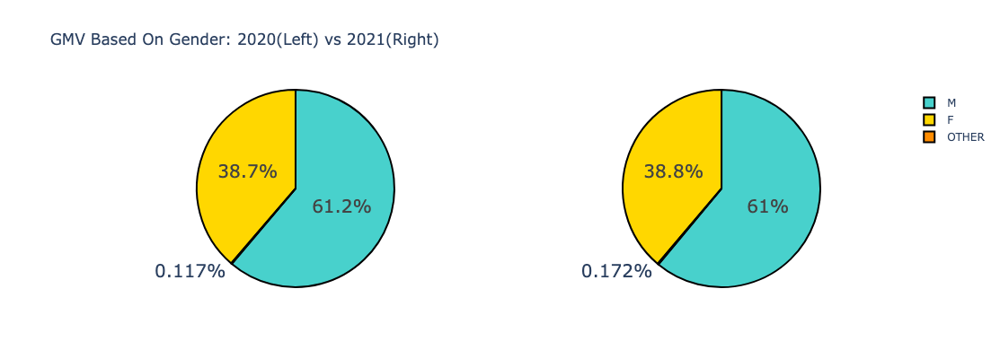

In [31]:
# separating yearwise data for visulizing
gender_data_2020 = gender_df[gender_df.year == 2020]
gender_data_2021 = gender_df[gender_df.year == 2021]

colors = ['gold', 'mediumturquoise', 'darkorange', 'lightgreen']
fig = make_subplots(rows=1, cols=2,
specs=[[{"type": "domain"}, {"type": "domain"}]])

fig.add_trace(go.Pie(labels=gender_data_2020.gender, values=gender_data_2020.amount.values), row=1, col=1)
fig.add_trace(go.Pie(labels=gender_data_2021.gender, values=gender_data_2021.amount.values), row=1, col=2)

fig.update_layout(height=400, title_text="GMV Based On Gender: 2020(Left) vs 2021(Right)")
fig.update_traces(textinfo='percent', textfont_size=20, marker=dict(colors=colors, line=dict(color='#000000', width=2)))
fig.show()

#### 11. Analysing GMV month wise

In [32]:
import calendar
month_wise_data = df.groupby(['month', 'year']).agg({'amount': 'sum'}).reset_index()

# Map numeric months to their corresponding names (words)
month_wise_data['month_name'] = month_wise_data['month'].apply(lambda x: calendar.month_name[x])

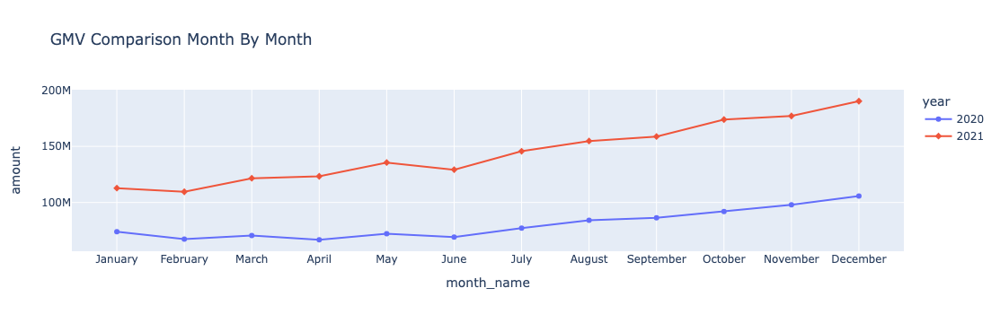

In [33]:
fig = px.line(month_wise_data, x="month_name", y="amount", color='year', symbol="year", title="GMV Comparison Month By Month")
fig.show()

#### 12. Analysing GMV per day

In [34]:
# grouping data date wise
date_wise_data = df.groupby(['date', 'year']).agg({'amount': 'sum'}).reset_index()

# Convert the 'date' column to datetime format
date_wise_data['date'] = pd.to_datetime(date_wise_data['date'])

# Sort the DataFrame by the 'date' column
date_wise_data = date_wise_data.sort_values(by='date')

In [35]:
date_wise_data_2020 = date_wise_data[date_wise_data.year == 2020]
date_wise_data_2021 = date_wise_data[date_wise_data.year == 2021]

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



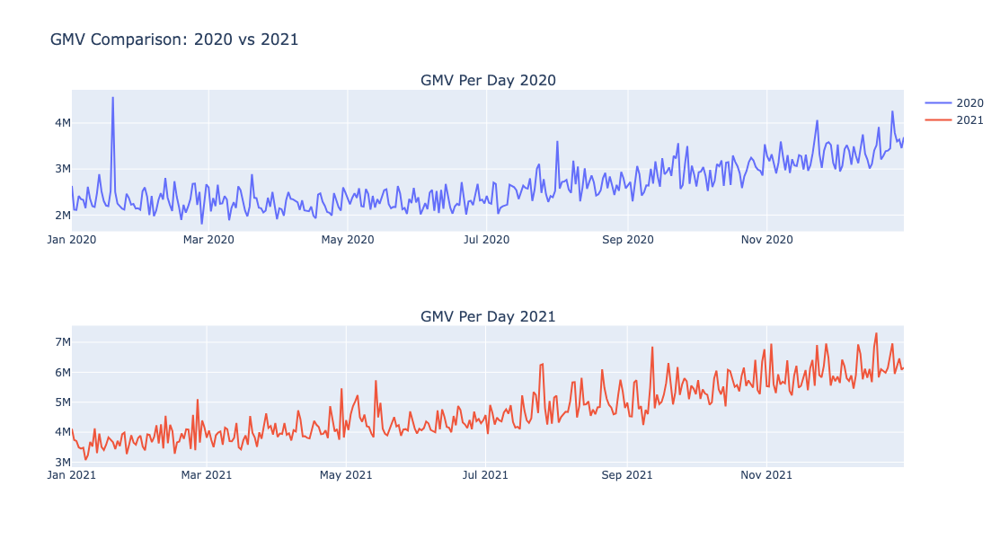

In [36]:
# Create subplots with 2 rows and 1 column
fig = make_subplots(rows=2, cols=1, subplot_titles=("GMV Per Day 2020", "GMV Per Day 2021"))

# Add first line chart to the first subplot
fig.add_trace(go.Scatter(x=date_wise_data_2020['date'], y=date_wise_data_2020['amount'], mode='lines', name='2020'), row=1, col=1)

# Add second line chart to the second subplot
# Assuming 'date_wise_data_2' is your DataFrame for the second line chart
fig.add_trace(go.Scatter(x=date_wise_data_2021['date'], y=date_wise_data_2021['amount'], mode='lines', name='2021'), row=2, col=1)

# Update layout
fig.update_layout(height=600, title_text="GMV Comparison: 2020 vs 2021")

# Show the combined figure
fig.show()

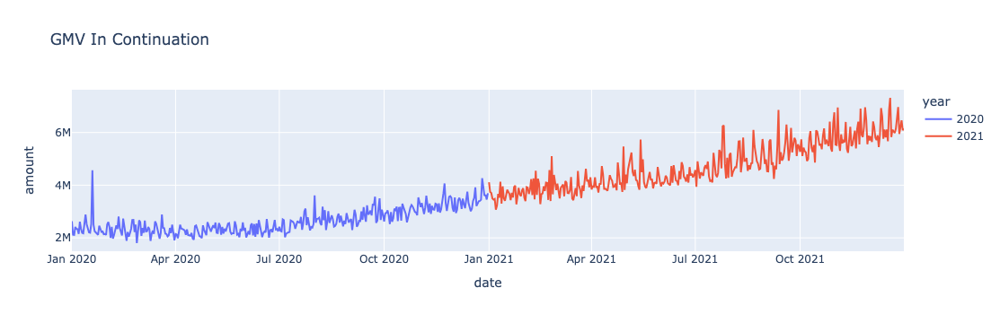

In [37]:
px.line(date_wise_data, x='date', y='amount', color='year', title ="GMV In Continuation")

As the plot is inclining upward, this indicates a trend. However, no sign of seasonality or cyclicity can be observed.

#### 13. Moving Average

Let's plot data along with 90 day moving average, to confirm the upward trend.

In [38]:
gmv_df = df.groupby(['date']).agg({'amount': 'sum'}).reset_index()

In [39]:
gmv_df['roll_mean'] = gmv_df['amount'].rolling(window=90).mean()

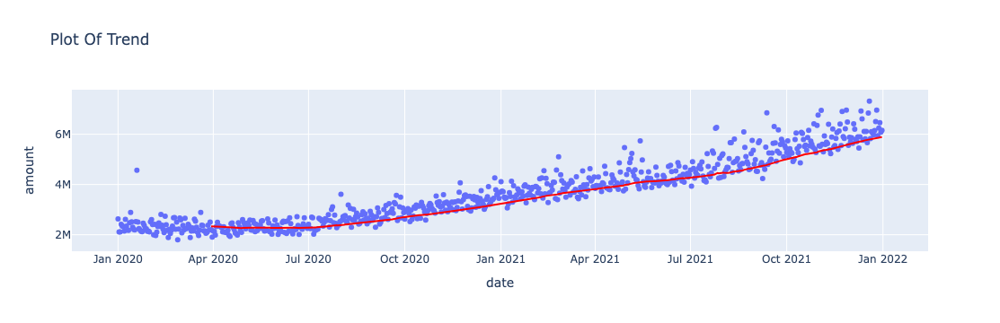

In [40]:
fig = px.scatter(gmv_df, x="date", y="amount", title= "Plot Of Trend")

# Add the line plot for moving average
line_trace = px.line(gmv_df, x='date', y='roll_mean')
line_trace.update_traces(line=dict(color='red'), name='roll_mean')
fig.add_trace(line_trace.data[0])
fig.show()

A clear trend can be noticed in the above plot, after 90 days moving average is observed against data. 

#### 14. Stationarity Of The TS

14.a. Augmented Dickey–Fuller test for stationarity

In [41]:
#Perform Augmented Dickey–Fuller test:
print('Results of Dickey Fuller Test:')
dftest = adfuller(gmv_df['amount'], autolag='AIC')

dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
    
print(dfoutput)

Results of Dickey Fuller Test:
Test Statistic                   2.073029
p-value                          0.998761
#Lags Used                      20.000000
Number of Observations Used    710.000000
Critical Value (1%)             -3.439594
Critical Value (5%)             -2.865619
Critical Value (10%)            -2.568942
dtype: float64


Here p-value is very large, which shows that time series is not stationary. 

14.b. Data Transformation to achieve Stationarity 

In [42]:
# Log scaling amount values
gmv_df['amount_log'] = np.log(gmv_df['amount'])

# calculating difference shift=1
gmv_df['amount_log_diff_shift'] = gmv_df['amount_log'] - gmv_df['amount_log'].shift()

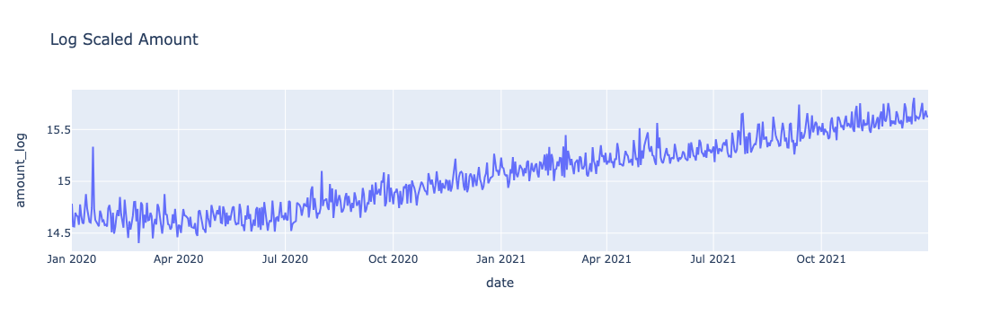

In [43]:
px.line(gmv_df, x='date', y='amount_log', title= "Log Scaled Amount")

In [44]:
# calculating moving average of log scaled amount
gmv_df['roll_mean_log'] = gmv_df['amount_log'].rolling(window=90).mean()

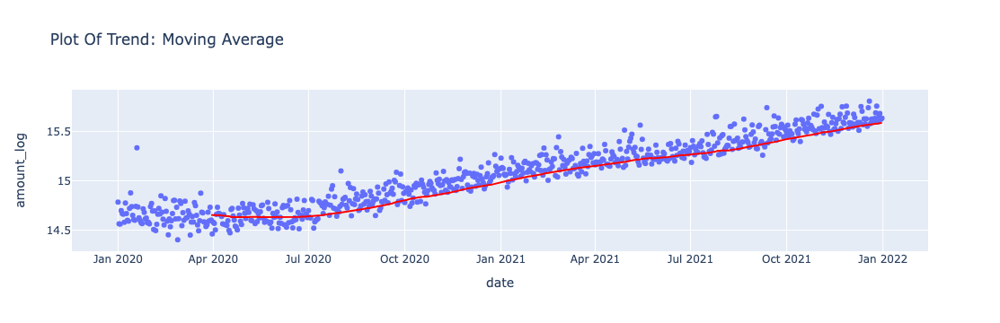

In [45]:
fig = px.scatter(gmv_df, x="date", y="amount_log", title= "Plot Of Trend: Moving Average")

# Add the line plot for moving average
line_trace = px.line(gmv_df, x='date', y='roll_mean_log')
line_trace.update_traces(line=dict(color='red'), name='roll_mean')
fig.add_trace(line_trace.data[0])
fig.show()

Note:   Below we will calculate "amountLogMinusMovingAverageLog" which is difference of log scaled amount column "amount_log" 
        and moving average calculated on same "amount_log" calculated above.

In [46]:
gmv_df['amountLogMinusMovingAverageLog'] = gmv_df['amount_log'] - gmv_df['roll_mean_log']

In [47]:
amountLogMinusMovingAverageLog_df = gmv_df[['date', 'amountLogMinusMovingAverageLog']]
amountLogMinusMovingAverageLog_df = amountLogMinusMovingAverageLog_df.dropna()

In [48]:
amountLogMinusMovingAverageLog_df.head(5)

,date,amountLogMinusMovingAverageLog
89,2020-03-30,-0.052559
90,2020-03-31,-0.190985
91,2020-04-01,-0.072746
92,2020-04-02,-0.082680
93,2020-04-03,-0.148263


In [49]:
amountLogMinusMovingAverageLog_df['mavg_amountLogMinusMovingAverageLog'] = amountLogMinusMovingAverageLog_df['amountLogMinusMovingAverageLog'].rolling(window=90).mean()
amountLogMinusMovingAverageLog_df['mstd_amountLogMinusRollStdLog'] = amountLogMinusMovingAverageLog_df['amountLogMinusMovingAverageLog'].rolling(window=90).std()

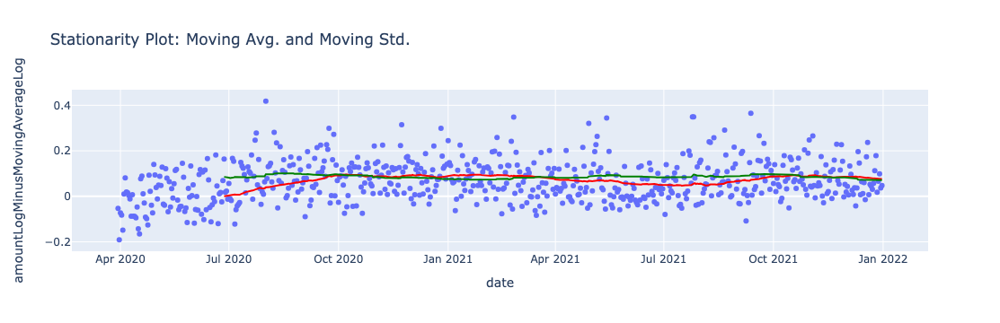

In [50]:
fig = px.scatter(amountLogMinusMovingAverageLog_df, x="date", y="amountLogMinusMovingAverageLog", title= "Stationarity Plot: Moving Avg. and Moving Std.")

# Add the line plot for moving average
line_trace = px.line(amountLogMinusMovingAverageLog_df, x='date', y='mavg_amountLogMinusMovingAverageLog')
line_trace.update_traces(line=dict(color='red'), name='mean')

line_trace_2 = px.line(amountLogMinusMovingAverageLog_df, x='date', y='mstd_amountLogMinusRollStdLog')
line_trace_2.update_traces(line=dict(color='green'), name='std')

fig.add_trace(line_trace.data[0])
fig.add_trace(line_trace_2.data[0])

fig.show()

Above plot shows that "subtracting two related series having similar trend components will make the result stationary".
Let's make this sure with ADF test below.

In [51]:
# Perform Augmented Dickey–Fuller test again
print('Results of Dickey Fuller Test:')
dftest = adfuller(amountLogMinusMovingAverageLog_df['amountLogMinusMovingAverageLog'], autolag='AIC')

dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
    
print(dfoutput)

Results of Dickey Fuller Test:
Test Statistic                  -3.933553
p-value                          0.001801
#Lags Used                      20.000000
Number of Observations Used    621.000000
Critical Value (1%)             -3.440924
Critical Value (5%)             -2.866205
Critical Value (10%)            -2.569255
dtype: float64


As we can see, p-value(0.001801) < 0.05, therefore we can conclude that our time series is now **stationary**.

##### Using ARIMA with log scaled values would be a good idea here, as it has both auto-regressive and moving average component with difference.

In [52]:
log_scaled_data = gmv_df[['date', 'amount', 'amount_log']]

### Modeling begins here!!

In [53]:
log_scaled_data['date'] = pd.to_datetime(log_scaled_data['date'])
log_scaled_data = log_scaled_data.set_index('date')

/var/folders/5g/d264hcgd60d1mxb1l4_f6vrr0000gn/T/ipykernel_93187/2938910741.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [54]:
last = log_scaled_data.shape[0]
cutoff = math.ceil(0.85 * last) # using 85% data for training and 15% for test

In [55]:
train, test = log_scaled_data[:cutoff], log_scaled_data[cutoff:]

In [56]:
model = ARIMA(train['amount_log'], order=(2,1,2)) # order was found by looking at Auto-Correlation & Partial Auto-Correlation Function

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



In [57]:
results_ARIMA = model.fit()

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



In [58]:
test['predictions_arima_log'] = results_ARIMA.predict(start=min(test.index),end=max(test.index))

/var/folders/5g/d264hcgd60d1mxb1l4_f6vrr0000gn/T/ipykernel_93187/2605878693.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [59]:
plot_test = test.reset_index()

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



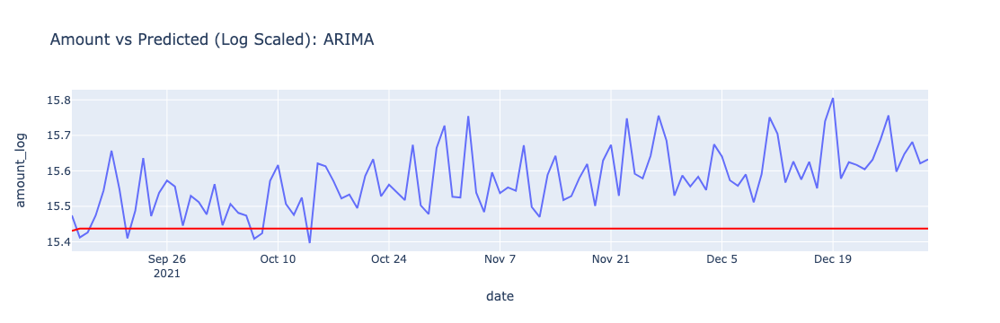

In [60]:
fig = px.line(plot_test, x='date', y='amount_log', title="Amount vs Predicted (Log Scaled): ARIMA")
line_trace = px.line(plot_test, x='date', y='predictions_arima_log')
line_trace.update_traces(line=dict(color='red'), name='predictions')
fig.add_trace(line_trace.data[0])
fig.show()

##### Calculating RMSE: ARIMA

In [61]:
rmse = np.sqrt(mean_squared_error(test['amount_log'], test['predictions_arima_log']))
print(f"RMSE value for ARIMA: {rmse}")

RMSE value for ARIMA: 0.16015449804708912


Clearly, ARIMA did a poor job predicting the result even on test data. We can try another popular model called **"Prophet"**

##### Using Prophet model for time series.

In [62]:
# creating ds and y columsn needed for prophet model
train = train.reset_index()
train = train.rename(columns={'amount_log': 'y', 'date': 'ds'})

In [63]:
# creating model instance and fit training data to it.
prophet_model=Prophet(growth='linear')
prophet_model.fit(train[['ds', 'y']])

# creating future dates
future_till_dec = prophet_model.make_future_dataframe(periods=test.shape[0])
forecast = prophet_model.predict(future_till_dec)
forecast = forecast.set_index('ds')

05:57:07 - cmdstanpy - INFO - Chain [1] start processing
05:57:07 - cmdstanpy - INFO - Chain [1] done processing


In [64]:
test['predictions_prophet_log'] = forecast[forecast.index.isin(test.index)]['yhat']

/var/folders/5g/d264hcgd60d1mxb1l4_f6vrr0000gn/T/ipykernel_93187/1771277901.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [65]:
plot_test = test.reset_index()

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



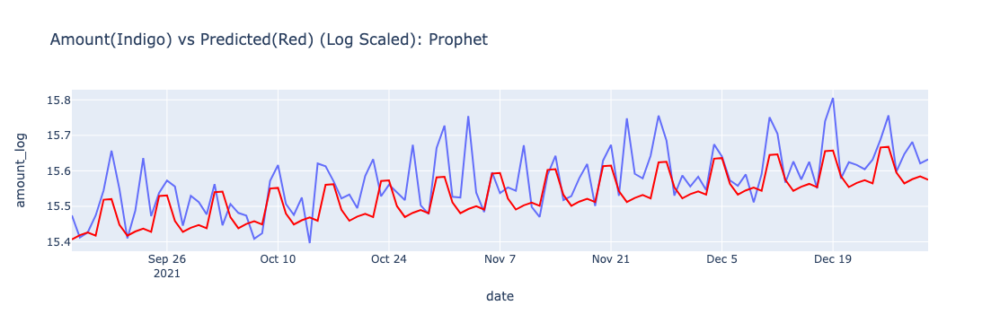

In [66]:
fig = px.line(plot_test, x='date', y='amount_log', title="Amount(Indigo) vs Predicted(Red) (Log Scaled): Prophet")
line_trace = px.line(plot_test, x='date', y='predictions_prophet_log')
line_trace.update_traces(line=dict(color='red'), name='predictions')
fig.add_trace(line_trace.data[0])
fig.show()

In [67]:
rmse = np.sqrt(mean_squared_error(test['amount_log'], test['predictions_prophet_log']))
print(f"RMSE value for PROPHET: {rmse}")

RMSE value for PROPHET: 0.0757704345445935


Looking at RMSE, It is obvious that PROPHET performed better than ARIMA.

##### Now, lets predict GMV for each day in month of January 2022

In [68]:
number_of_steps_in_future = test.shape[0] + 31 # number of days in January
january = prophet_model.make_future_dataframe(periods=number_of_steps_in_future)

In [69]:
predictions_january_df = prophet_model.predict(january)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



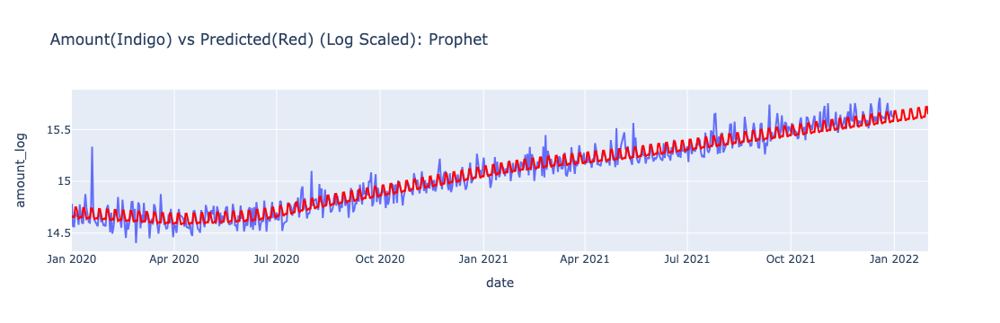

In [70]:
fig = px.line(log_scaled_data.reset_index(), x='date', y='amount_log', title="Amount(Indigo) vs Predicted(Red) (Log Scaled): Prophet")
line_trace = px.line(predictions_january_df, x='ds', y='yhat')
line_trace.update_traces(line=dict(color='red'), name='predictions')
fig.add_trace(line_trace.data[0])
fig.show()

##### Scaling values back to original

In [71]:
predictions_january_df['amount'] = np.exp(predictions_january_df['yhat'])

In [72]:
# saving results to a file
prohet_results = predictions_january_df[-31:]
prohet_results = prohet_results.rename(columns={'ds': 'date'})
prohet_results = prohet_results[['date', 'amount']]
prohet_results.to_csv(os.path.join(file_path, "prophet_model_day_wise_gmv_january_2022.csv"))

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



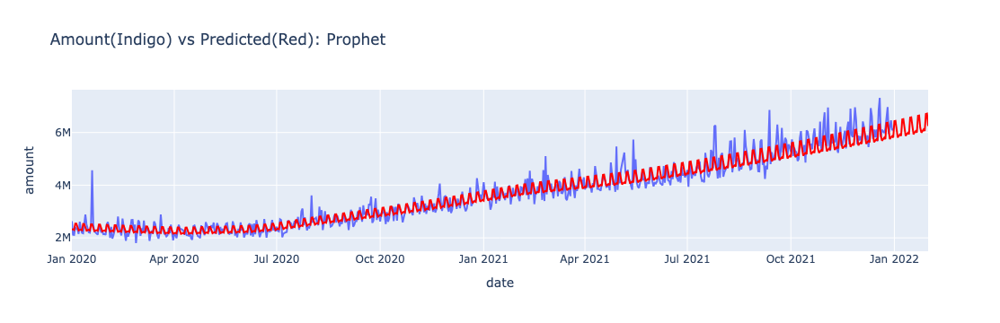

In [73]:
fig = px.line(gmv_df, x='date', y='amount', title="Amount(Indigo) vs Predicted(Red): Prophet")
line_trace = px.line(predictions_january_df, x='ds', y='amount')
line_trace.update_traces(line=dict(color='red'), name='predictions')
fig.add_trace(line_trace.data[0])
fig.show()

#### Trying GRU model 

In [74]:
# initialise random states for same results every time code is run
np.random.seed(0)
tf.random.set_seed(0)
random.seed(0)

# generate the input and output sequences
n_lookback = 45  # length of input sequences (lookback period)
n_forecast = 31  # length of output sequences (forecast period)

In [75]:
# creating lstm_df dataset
gru_df = gmv_df[['date', 'amount']]
gru_df = gru_df.set_index('date')

In [76]:
# setting and reshaping target variable
target = gru_df['amount']
target = target.values.reshape(-1, 1)

In [77]:
# scale the data
scaler = MinMaxScaler(feature_range=(0, 1))
scaler = scaler.fit(target)
target = scaler.transform(target)

In [78]:
# creating new_input and new_target
new_input, new_target = [], []
for i in range(n_lookback, len(target) - n_forecast + 1):
    new_input.append(target[i - n_lookback: i])
    new_target.append(target[i: i + n_forecast])

new_input, new_target = np.array(new_input), np.array(new_target)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 45, 64)            12864     
                                                                 
 gru_1 (GRU)                 (None, 32)                9408      
                                                                 
 dropout (Dropout)           (None, 32)                0         
                                                                 
 dense (Dense)               (None, 31)                1023      
                                                                 
Total params: 23295 (91.00 KB)
Trainable params: 23295 (91.00 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/5
37/37 [==============================] - 2s 20ms/step - loss: 0.1034 - val_loss: 0.2848
Epoch 2/5
37/37 [==============================] - 0s 

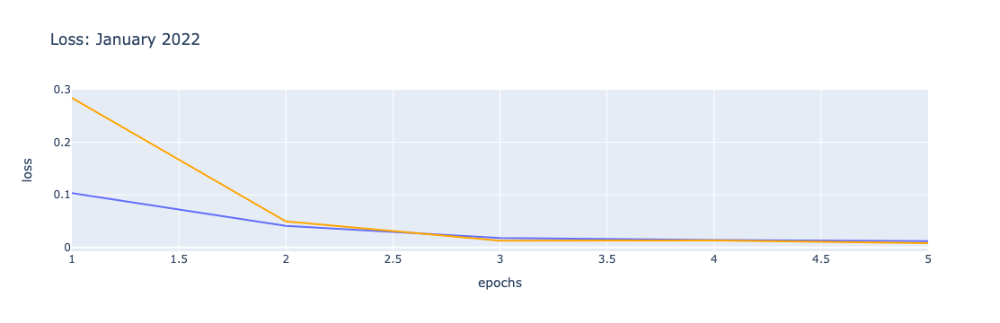

In [79]:
gru_model = Sequential()
gru_model.add(GRU(64, activation='relu', input_shape=(new_input.shape[1], new_input.shape[2]), return_sequences=True))
gru_model.add(GRU(32, activation='relu', return_sequences=False))
gru_model.add(Dropout(0.2))
gru_model.add(Dense(new_target.shape[1]))
gru_model.compile(optimizer='adam', loss='mse')
gru_model.summary()

history = gru_model.fit(new_input, new_target, epochs=5, batch_size=16, validation_split=0.1, verbose=1)

history = pd.DataFrame(history.history)
epochs = np.arange(1, history.shape[0]+1)
history["epochs"] = epochs

fig = px.line(history, x='epochs', y='loss', title="Loss: January 2022")
line_trace = px.line(history, x='epochs', y='val_loss')
line_trace.update_traces(line=dict(color='orange'))
fig.add_trace(line_trace.data[0])
fig.show()

In [80]:
# generate the forecasts
X_ = target[- n_lookback:]  # last available input sequence
X_ = X_.reshape(1, n_lookback, 1)

Y_ = gru_model.predict(X_).reshape(-1, 1)
Y_ = scaler.inverse_transform(Y_)

1/1 [==============================] - 0s 206ms/step


In [81]:
# organize the results in a data frame
df_past = gru_df[['amount']].reset_index()
df_past.rename(columns={'index': 'date', 'amount': 'actual'}, inplace=True)
df_past['date'] = pd.to_datetime(df_past['date'])
df_past['forecast'] = np.nan
df_past['forecast'].iloc[-1] = df_past['actual'].iloc[-1]

df_future = pd.DataFrame(columns=['date', 'actual', 'forecast'])
df_future['date'] = pd.date_range(start=df_past['date'].iloc[-1] + pd.Timedelta(days=1), periods=n_forecast)
df_future['forecast'] = Y_.flatten()
df_future['actual'] = np.nan

results = pd.concat([df_past, df_future]).set_index('date')
results=results.reset_index()

/var/folders/5g/d264hcgd60d1mxb1l4_f6vrr0000gn/T/ipykernel_93187/36240090.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



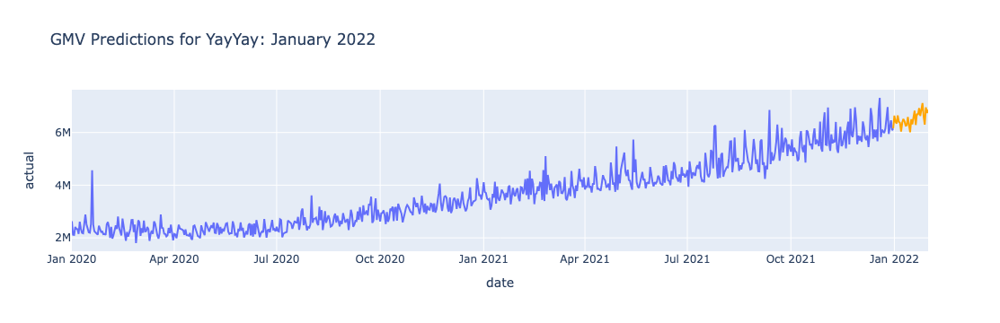

In [82]:
fig = px.line(results, x='date', y='actual', title="GMV Predictions for YayYay: January 2022")
line_trace = px.line(results, x='date', y='forecast')
line_trace.update_traces(line=dict(color='orange'))
fig.add_trace(line_trace.data[0])
fig.show()

In [83]:
results = results.drop(columns=['actual'])
results = results.dropna()

In [84]:
# saving results to a file
results.to_csv(os.path.join(file_path,"gru_model_day_wise_gmv_january_2022.csv"))

### Predicting User GMV for Jan 2022 

In [85]:
gmv_user = df.groupby(['id', 'month', 'year']).agg({'amount': 'sum'}).reset_index()
gmv_user['month'] = gmv_user.apply(lambda row: row['month']+12 if row['year']>2020 else row['month'], axis=1)

# Pivot the DataFrame
pivot_df = gmv_user.pivot_table(index='id', columns='month', values='amount', fill_value=0)

# Reorder columns from 1 to 25
pivot_df = pivot_df.reindex(columns=range(1, 25), fill_value=0)

In [86]:
def exponential_average(series, alpha):
    # Initialize forecast value with the last observed value
    forecast = series.iloc[-1]
    
    for value in series:
        forecast = alpha * value + (1 - alpha) * forecast
    return np.round(forecast, decimals=2)

In [87]:
pivot_df['25'] = pivot_df.apply(lambda row: exponential_average(row, 0.2), axis=1)

In [88]:
def rename_columns(columns):
    year = 2020
    new_column_names = []
    for col in columns:
        if int(col)<=12:
            new_column_names.append(calendar.month_name[int(col)] + " "+ str(year))
        else:
            col = (int(col)-12)%12 if (int(col)-12) > 12 else (int(col)-12)
            new_column_names.append(calendar.month_name[col] + " "+ str(year))
            
        if int(col)%12==0:
            year+=1
    return new_column_names

In [89]:
pivot_df.columns = rename_columns(pivot_df.columns)

In [90]:
pivot_df.columns

Index(['January 2020', 'February 2020', 'March 2020', 'April 2020', 'May 2020',
       'June 2020', 'July 2020', 'August 2020', 'September 2020',
       'October 2020', 'November 2020', 'December 2020', 'January 2021',
       'February 2021', 'March 2021', 'April 2021', 'May 2021', 'June 2021',
       'July 2021', 'August 2021', 'September 2021', 'October 2021',
       'November 2021', 'December 2021', 'January 2022'],
      dtype='object')

In [91]:
pivot_df = pivot_df.reset_index()

In [92]:
pivot_df.to_csv(os.path.join(file_path,"user_gmv_month_january_2022.csv"))